**Question: Do frequent reviewers tend to give harsher or more lenient scores compared to first-time reviewers?**

##Objective
To investigate whether frequent reviewers tend to give harsher reviews in luxury hotels across Europe.

##Research Question
Is there a significant relationship between review frequency and the review behavior of customers in luxury hotel reviews? If so, does increased review frequency correlate with more lenient review?


## Make a logical case for the possibility of multiple outcomes.
####outcome 1: Frequent reviewers will leave more positive reviews
####outcome 2: Frequent reviewers will leave more negative reviews
####outcome 3: There is no relationship between review frequency and review sentiment.

##What is the ideal experiment to examine the issue?

##Present descriptive statistics/visualizations describing your data.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import os

# Replace the path the actual folder name
os.chdir('/content/drive/MyDrive/DSO510_Project')

# Confirm that the files are accessible
os.listdir()

['BA trend presentation.gslides',
 'Hotel_Reviews.csv',
 '16203_TeamByte4Burgers.mp4',
 'Initial Feedback.gdoc',
 'DSO 510 Video Slides.gslides',
 'Project_Codes.ipynb']

In [4]:
import pandas as pd
data = pd.read_csv('Hotel_Reviews.csv')

In [ ]:
data.head()

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968


In [ ]:
# prompt: how many first time reviewer(column name is  Total_Number_of_Reviews_Reviewer_Has_Given <=10; and how many frequent reviewers( total number of reviews has given >10)

# Assuming 'data' DataFrame is already loaded as shown in the provided code.
first_time_reviewers = data[data['Total_Number_of_Reviews_Reviewer_Has_Given'] <= 10]
frequent_reviewers = data[data['Total_Number_of_Reviews_Reviewer_Has_Given'] > 10]

num_first_time = len(first_time_reviewers)
num_frequent = len(frequent_reviewers)

print(f"Number of first-time reviewers: {num_first_time}")
print(f"Number of frequent reviewers: {num_frequent}")


Number of first-time reviewers: 413864
Number of frequent reviewers: 101874


In [ ]:
first_time_reviewers = data[data['Total_Number_of_Reviews_Reviewer_Has_Given'] <= 3]
frequent_reviewers = data[data['Total_Number_of_Reviews_Reviewer_Has_Given'] > 3]

num_first_time = len(first_time_reviewers)
num_frequent = len(frequent_reviewers)

print(f"Number of first-time reviewers: {num_first_time}")
print(f"Number of frequent reviewers: {num_frequent}")

Number of first-time reviewers: 268562
Number of frequent reviewers: 247176


In [ ]:
# prompt: please add a new column, classfy the user by number of their reviews, 'non-fre' for those Total_Number_of_Reviews_Reviewer_Has_Given'] <= 3 and 'fre' othervise.

import pandas as pd

# Assuming 'data' DataFrame is already loaded as shown in the provided code.

# Create the 'User_Class' column based on the condition
data['User_Class'] = data['Total_Number_of_Reviews_Reviewer_Has_Given'].apply(lambda x: 'non-fre' if x <= 3 else 'fre')

# Now you can use the 'User_Class' column for your analysis. For example:
data.head()


,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng,User_Class
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968,fre
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968,fre
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968,fre
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968,non-fre
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968,non-fre


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


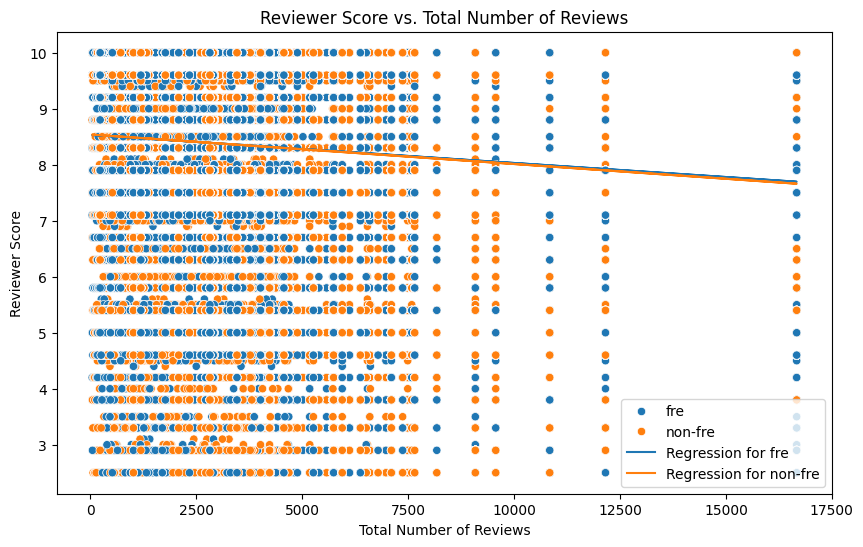

In [ ]:
# prompt: visulaze the reviewer score from reviewe['reviewer score'] and the total number of reviews ['Total_Number_of_Reviews' is the column name] for users classfied as non-fre and fre as two groups with different color. Create the scatter plot with a linear regression line

import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

# Assuming 'data' DataFrame is already loaded and 'User_Class' column exists

# Create the scatter plot with linear regression lines
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Total_Number_of_Reviews', y='Reviewer_Score', hue='User_Class', data=data)


# Calculate and plot the linear regression lines for each group
for user_class in data['User_Class'].unique():
    subset = data[data['User_Class'] == user_class]
    slope, intercept, r_value, p_value, std_err = stats.linregress(subset['Total_Number_of_Reviews'], subset['Reviewer_Score'])
    plt.plot(subset['Total_Number_of_Reviews'], intercept + slope * subset['Total_Number_of_Reviews'], label=f'Regression for {user_class}')

plt.xlabel('Total Number of Reviews')
plt.ylabel('Reviewer Score')
plt.title('Reviewer Score vs. Total Number of Reviews')
plt.legend()
plt.show()


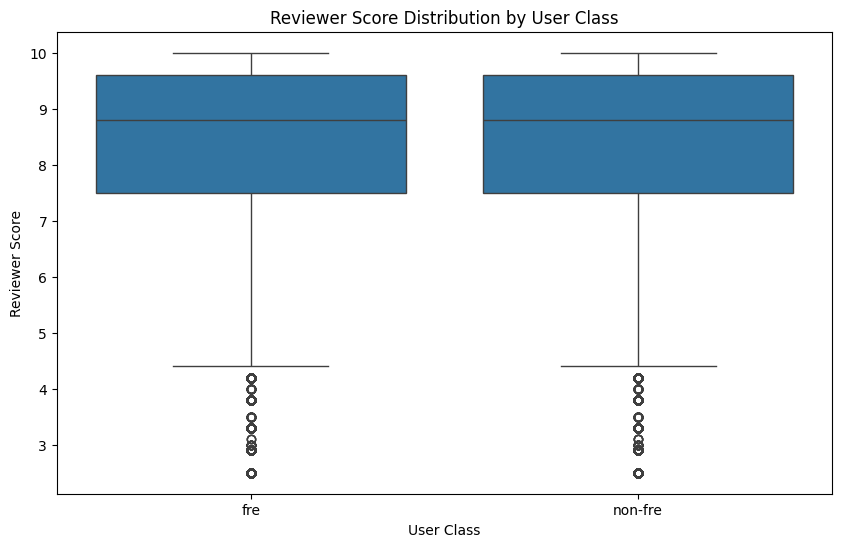

,count,mean,std,min,25%,50%,75%,max
User_Class,,,,,,,,
fre,247176.0,8.398497,1.567537,2.5,7.5,8.8,9.6,10.0
non-fre,268562.0,8.391928,1.700004,2.5,7.5,8.8,9.6,10.0


from matplotlib import pyplot as plt
_df_0['count'].plot(kind='hist', bins=20, title='count')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_1['mean'].plot(kind='hist', bins=20, title='mean')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_2['std'].plot(kind='hist', bins=20, title='std')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_3.groupby('User_Class').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_4.plot(kind='scatter', x='count', y='mean', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_5.plot(kind='scatter', x='mean', y='std', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['count']
  ys = series['mean']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_6.sort_values('count', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('User_Class')):
  _plot_series(series, series_name, i)
  fig.legend(title='User_Class', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('count')
_ = plt.ylabel('mean')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['count']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'count'}, axis=1)
              .sort_values('count', ascending=True))
  xs = counted['count']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_7.sort_values('count', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('User_Class')):
  _plot_series(series, series_name, i)
  fig.legend(title='User_Class', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('count')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['std']
  ys = series['mean']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_8.sort_values('std', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('User_Class')):
  _plot_series(series, series_name, i)
  fig.legend(title='User_Class', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('std')
_ = plt.ylabel('mean')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['std']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'std'}, axis=1)
              .sort_values('std', ascending=True))
  xs = counted['std']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_9.sort_values('std', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('User_Class')):
  _plot_series(series, series_name, i)
  fig.legend(title='User_Class', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('std')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
_df_10['count'].plot(kind='line', figsize=(8, 4), title='count')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_11['mean'].plot(kind='line', figsize=(8, 4), title='mean')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_12['std'].plot(kind='line', figsize=(8, 4), title='std')
plt.gca().spines[['top', 'right']].set_visible(False)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_13['User_Class'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_13, x='count', y='User_Class', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_14['User_Class'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_14, x='mean', y='User_Class', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_15['User_Class'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_15, x='std', y='User_Class', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

In [ ]:
# prompt: visulaze the reviewer score from reviewe['reviewer score'] and the total number of reviews ['Total_Number_of_Reviews_reviewer_has_given' is the column name] for users classfied as non-fre and fre as two groups with different color. Create a boxplot and give me discriptive data

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'data' DataFrame is already loaded and 'User_Class' column exists

# Create the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x='User_Class', y='Reviewer_Score', data=data)
plt.xlabel('User Class')
plt.ylabel('Reviewer Score')
plt.title('Reviewer Score Distribution by User Class')
plt.show()

# Descriptive statistics
descriptive_stats = data.groupby('User_Class')['Reviewer_Score'].describe()
descriptive_stats


Median of Total_Number_of_Reviews_Reviewer_Has_Given: 3.0


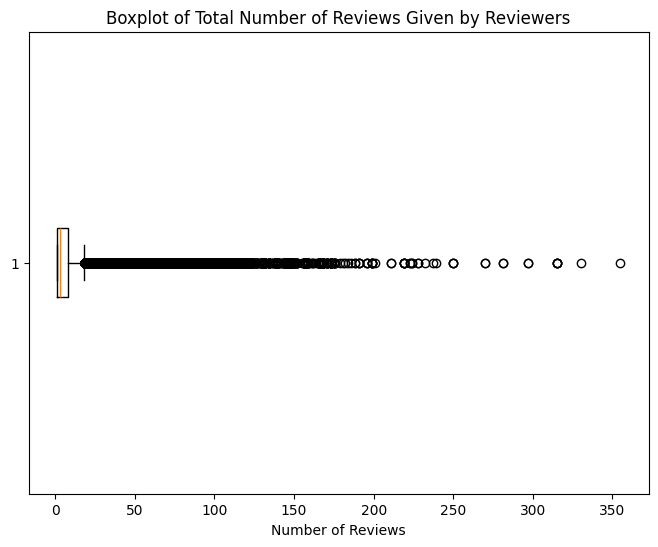

In [ ]:
# prompt: median of the Total_Number_of_Reviews_Reviewer_Has_Given, give me a boxplot

import matplotlib.pyplot as plt

# Calculate the median of 'Total_Number_of_Reviews_Reviewer_Has_Given'
median_reviews = data['Total_Number_of_Reviews_Reviewer_Has_Given'].median()
print(f"Median of Total_Number_of_Reviews_Reviewer_Has_Given: {median_reviews}")

# Create the boxplot
plt.figure(figsize=(8, 6))
plt.boxplot(data['Total_Number_of_Reviews_Reviewer_Has_Given'], vert=False)  # vert=False for horizontal boxplot
plt.title('Boxplot of Total Number of Reviews Given by Reviewers')
plt.xlabel('Number of Reviews')
plt.show()


In [ ]:
# prompt: how many hotels are in the data set

# Check the number of unique hotels in the dataset
num_hotels = data['Hotel_Name'].nunique()
print(f"There are {num_hotels} unique hotels in the dataset.")


There are 1492 unique hotels in the dataset.


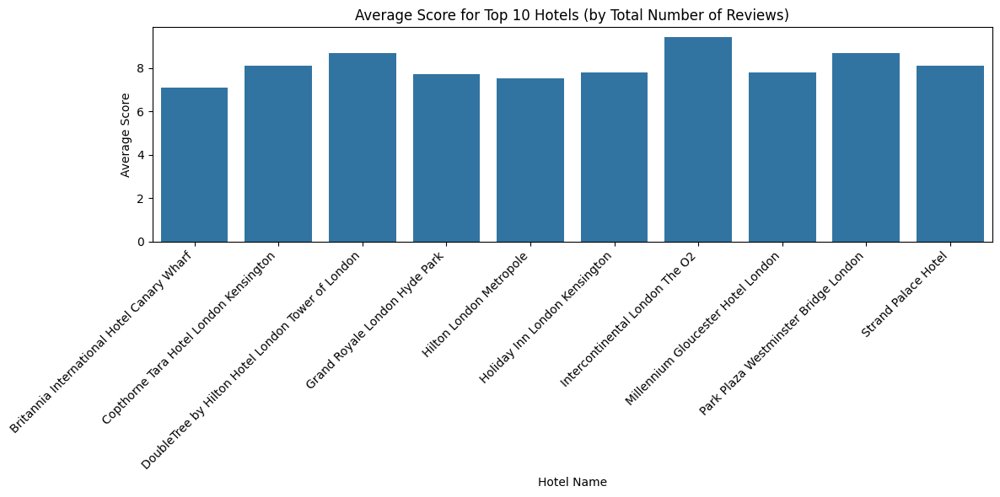

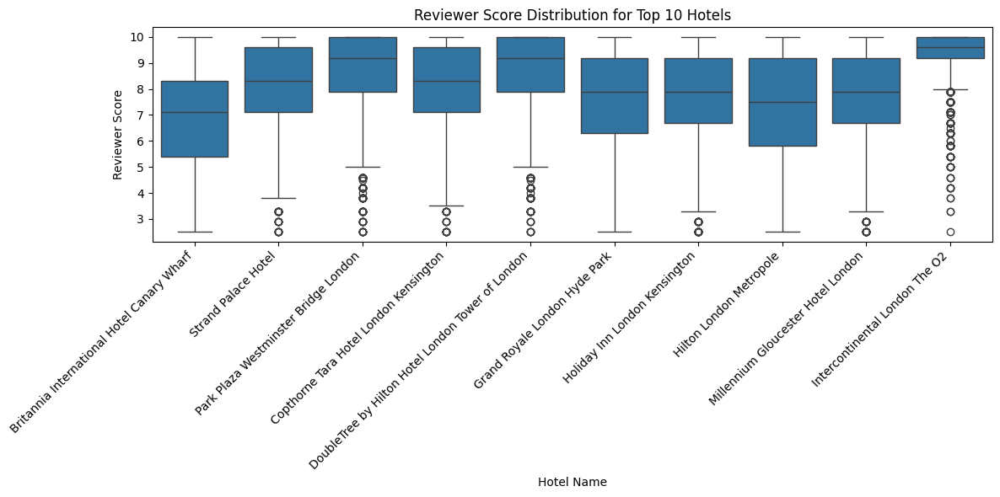

In [ ]:
# prompt:  want to have a visulazation for top 10(total number of reviews) hotel, show their average_score comparied with the reviewer score

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'data' DataFrame is already loaded as in the previous code.

# Group by hotel name and count reviews
hotel_review_counts = data.groupby('Hotel_Name')['Review_Total_Negative_Word_Counts'].count().reset_index()
hotel_review_counts = hotel_review_counts.rename(columns={'Review_Total_Negative_Word_Counts': 'Review_Count'})

# Sort by review count and get the top 10 hotels
top_10_hotels = hotel_review_counts.nlargest(10, 'Review_Count')

# Merge with the original data to get average scores and reviewer scores
top_10_data = pd.merge(top_10_hotels, data, on='Hotel_Name')

# Calculate average scores for the top 10 hotels
average_scores = top_10_data.groupby('Hotel_Name')['Average_Score'].mean().reset_index()

# Visualization
plt.figure(figsize=(12, 6))
sns.barplot(x='Hotel_Name', y='Average_Score', data=average_scores)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Hotel Name')
plt.ylabel('Average Score')
plt.title('Average Score for Top 10 Hotels (by Total Number of Reviews)')
plt.tight_layout()
plt.show()


# Additional visualization (optional): Reviewer score distribution for each of the top 10 hotels
plt.figure(figsize=(12, 6))
sns.boxplot(x='Hotel_Name', y='Reviewer_Score', data=top_10_data)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Hotel Name')
plt.ylabel('Reviewer Score')
plt.title('Reviewer Score Distribution for Top 10 Hotels')
plt.tight_layout()
plt.show()


In [ ]:
# prompt: give me the top ten hotels each individual statstic or their [average_score] and non-fre, fre average[Reviewer_Score]

import pandas as pd
# Assuming 'data' DataFrame is already loaded as in the previous code.

# Group by hotel name and count reviews
hotel_review_counts = data.groupby('Hotel_Name')['Review_Total_Negative_Word_Counts'].count().reset_index()
hotel_review_counts = hotel_review_counts.rename(columns={'Review_Total_Negative_Word_Counts': 'Review_Count'})

# Sort by review count and get the top 10 hotels
top_10_hotels = hotel_review_counts.nlargest(10, 'Review_Count')

# Merge with the original data to get average scores and reviewer scores
top_10_data = pd.merge(top_10_hotels, data, on='Hotel_Name')

# Calculate average scores and reviewer scores for the top 10 hotels
hotel_stats = top_10_data.groupby('Hotel_Name').agg(
    average_score=('Average_Score', 'mean'),
    non_fre_reviewer_score=('Reviewer_Score', lambda x: x[top_10_data['User_Class'] == 'non-fre'].mean()),
    fre_reviewer_score=('Reviewer_Score', lambda x: x[top_10_data['User_Class'] == 'fre'].mean())
).reset_index()

hotel_stats


,Hotel_Name,average_score,non_fre_reviewer_score,fre_reviewer_score
0,Britannia International Hotel Canary Wharf,7.1,6.789635,6.896212
1,Copthorne Tara Hotel London Kensington,8.1,8.139865,8.031833
2,DoubleTree by Hilton Hotel London Tower of London,8.7,8.654887,8.680140
3,Grand Royale London Hyde Park,7.7,7.560418,7.697978
4,Hilton London Metropole,7.5,7.353254,7.248478
5,Holiday Inn London Kensington,7.8,7.734788,7.705243
6,Intercontinental London The O2,9.4,9.479405,9.376748
7,Millennium Gloucester Hotel London,7.8,7.765843,7.535700
8,Park Plaza Westminster Bridge London,8.7,8.697532,8.595162
9,Strand Palace Hotel,8.1,8.169979,8.074905


                        average_score  non_fre_reviewer_score  \
average_score                1.000000                0.995085   
non_fre_reviewer_score       0.995085                1.000000   
fre_reviewer_score           0.993894                0.989997   

                        fre_reviewer_score  
average_score                     0.993894  
non_fre_reviewer_score            0.989997  
fre_reviewer_score                1.000000  


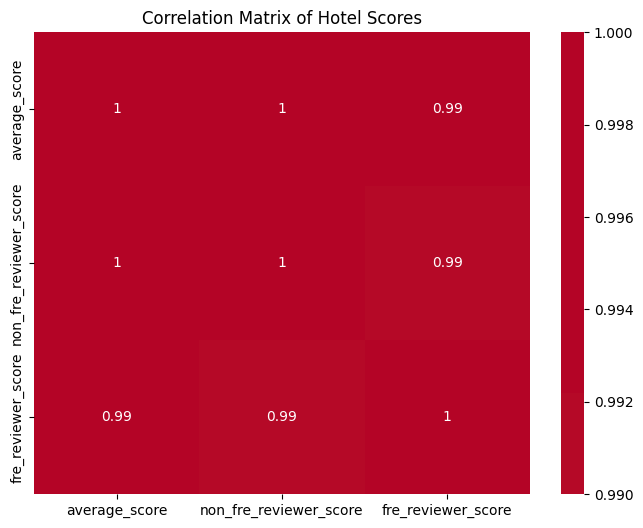

In [ ]:
# prompt: do we see any realtionships between the three variables, average_score, non_fre_reviewer_score and fre_reviewer_score

import matplotlib.pyplot as plt
# Assuming 'hotel_stats' DataFrame is already created as in the previous code.

# Correlation analysis
correlation_matrix = hotel_stats[['average_score', 'non_fre_reviewer_score', 'fre_reviewer_score']].corr()
print(correlation_matrix)

# Visualization of correlations
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix of Hotel Scores')
plt.show()


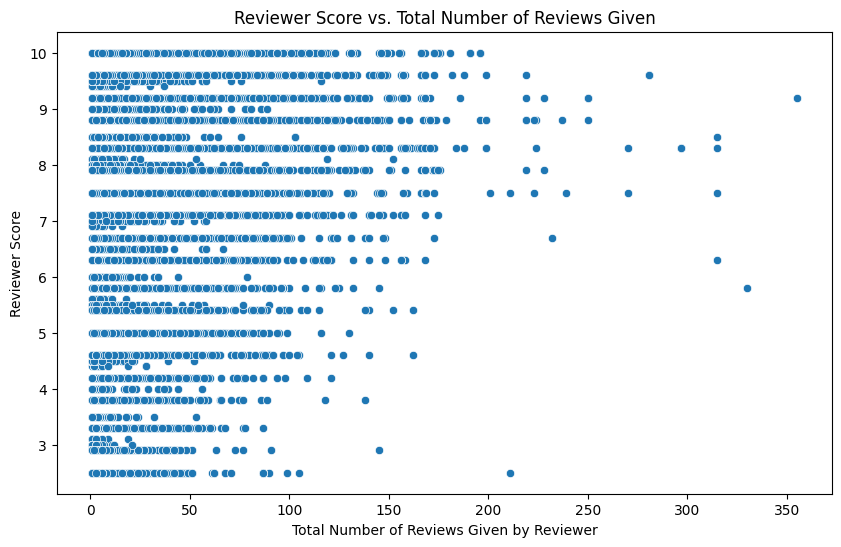

In [ ]:
# prompt: visulaze the reviewer score from reviewe['reviewer score'] and the total number of reviews the reviewers have given ['Total_Number_of_Reviews_Reviewer_Has_Given']

import matplotlib.pyplot as plt
# Assuming 'data' DataFrame is already loaded as in the previous code.

# Create a scatterplot
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Total_Number_of_Reviews_Reviewer_Has_Given', y='Reviewer_Score', data=data)
plt.xlabel('Total Number of Reviews Given by Reviewer')
plt.ylabel('Reviewer Score')
plt.title('Reviewer Score vs. Total Number of Reviews Given')
plt.show()


The correlation between Reviewer Score and Total Number of Reviews is: 0.0028729072390380715


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



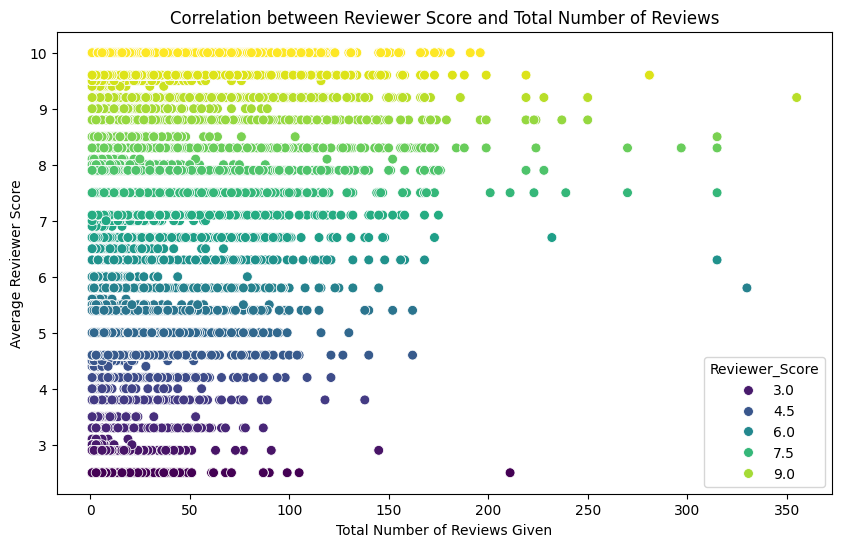

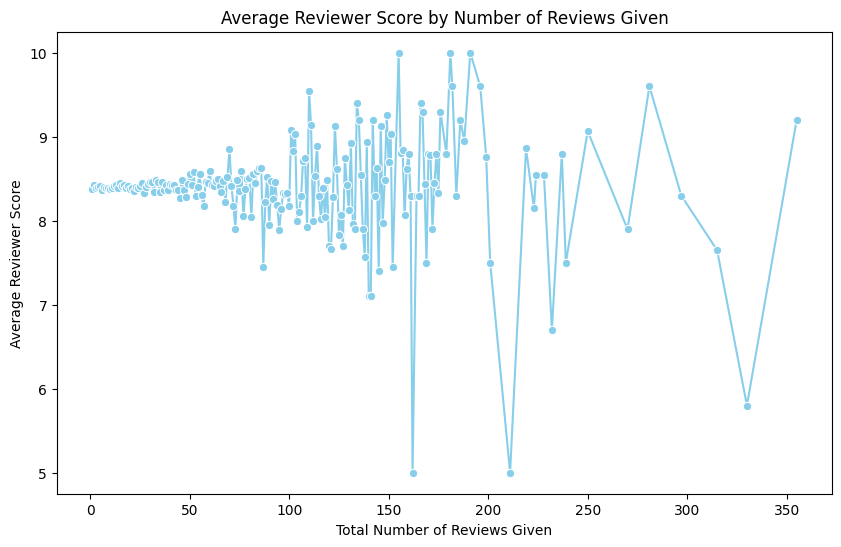

In [ ]:
# prompt: corrlation of reviewer score and total number reviews reviewer have given(Total_Number_of_Reviews_Reviewer_Has_Given) ; show me the average score with different color

import matplotlib.pyplot as plt
# Assuming 'data' DataFrame is already loaded as in the previous code.

# Calculate the correlation
correlation = data['Reviewer_Score'].corr(data['Total_Number_of_Reviews_Reviewer_Has_Given'])
print(f"The correlation between Reviewer Score and Total Number of Reviews is: {correlation}")

# Group data by 'Total_Number_of_Reviews_Reviewer_Has_Given' and calculate the mean 'Reviewer_Score'
average_scores_by_review_count = data.groupby('Total_Number_of_Reviews_Reviewer_Has_Given')['Reviewer_Score'].mean().reset_index()

# Create the scatter plot with color mapping
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Total_Number_of_Reviews_Reviewer_Has_Given', y='Reviewer_Score', data=data, hue='Reviewer_Score', palette='viridis', s=50) # Using 'viridis' color palette
plt.xlabel('Total Number of Reviews Given')
plt.ylabel('Average Reviewer Score')
plt.title('Correlation between Reviewer Score and Total Number of Reviews')
plt.show()


# Visualization of average scores by review count
plt.figure(figsize=(10, 6))
sns.lineplot(x='Total_Number_of_Reviews_Reviewer_Has_Given', y='Reviewer_Score', data=average_scores_by_review_count, marker='o', color='skyblue')
plt.xlabel('Total Number of Reviews Given')
plt.ylabel('Average Reviewer Score')
plt.title('Average Reviewer Score by Number of Reviews Given')
plt.show()


In [ ]:
data.columns

Index(['Hotel_Address', 'Additional_Number_of_Scoring', 'Review_Date',
       'Average_Score', 'Hotel_Name', 'Reviewer_Nationality',
       'Negative_Review', 'Review_Total_Negative_Word_Counts',
       'Total_Number_of_Reviews', 'Positive_Review',
       'Review_Total_Positive_Word_Counts',
       'Total_Number_of_Reviews_Reviewer_Has_Given', 'Reviewer_Score', 'Tags',
       'days_since_review', 'lat', 'lng'],
      dtype='object')

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Additional_Number_of_Scoring,515738.0,498.081836,500.538467,1.000000,169.000000,341.000000,660.000000,2682.000000
Average_Score,515738.0,8.397487,0.548048,5.200000,8.100000,8.400000,8.800000,9.800000
Review_Total_Negative_Word_Counts,515738.0,18.539450,29.690831,0.000000,2.000000,9.000000,23.000000,408.000000
Total_Number_of_Reviews,515738.0,2743.743944,2317.464868,43.000000,1161.000000,2134.000000,3613.000000,16670.000000
Review_Total_Positive_Word_Counts,515738.0,17.776458,21.804185,0.000000,5.000000,11.000000,22.000000,395.000000
Total_Number_of_Reviews_Reviewer_Has_Given,515738.0,7.166001,11.040228,1.000000,1.000000,3.000000,8.000000,355.000000
Reviewer_Score,515738.0,8.395077,1.637856,2.500000,7.500000,8.800000,9.600000,10.000000
lat,512470.0,49.442439,3.466325,41.328376,48.214662,51.499981,51.516288,52.400181
lng,512470.0,2.823803,4.579425,-0.369758,-0.143372,0.010607,4.834443,16.429233


In [ ]:
data.isna().sum()

,0
Hotel_Address,0
Additional_Number_of_Scoring,0
Review_Date,0
Average_Score,0
Hotel_Name,0
Reviewer_Nationality,0
Negative_Review,0
Review_Total_Negative_Word_Counts,0
Total_Number_of_Reviews,0
Positive_Review,0


In [ ]:
data.dropna(inplace=True,axis=0)

In [ ]:
print("Duplicated rows before: ",data.duplicated().sum())
data.drop_duplicates(inplace=True)
print("Duplicated rows after: ",data.duplicated().sum())

Duplicated rows before:  526
Duplicated rows after:  0


In [ ]:
import plotly.express as px
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [ ]:
!pip install plotly

In [ ]:
data.Reviewer_Nationality.nunique()

227

In [ ]:
fig = px.histogram(data, x="Average_Score", title='Review Average Score Distribution')
fig.show()

In [ ]:
# prompt: make a histogram of numbers of reviews from different nationality

import plotly.express as px

# Assuming 'data' DataFrame is already loaded as in the provided code.

fig = px.histogram(data, x="Reviewer_Nationality", title='Number of Reviews per Nationality')
fig.show()


In [ ]:
data.loc[:, 'Positive_Review'] = data.Positive_Review.apply(lambda x: x.replace('No Positive', ''))
data.loc[:, 'Negative_Review'] = data.Negative_Review.apply(lambda x: x.replace('No Negative', ''))

In [ ]:
data["Total_Review"] = data["Negative_Review"] + data["Positive_Review"]

In [ ]:
data["review_type"] = data["Reviewer_Score"].apply(
    lambda x: "Bad_review" if x < 7 else "Good_review")

In [ ]:
df_reviews = data[["Total_Review", "review_type"]]
df_reviews.head()

,Total_Review,review_type
0,I am so angry that i made this post available...,Bad_review
1,No real complaints the hotel was great great ...,Good_review
2,Rooms are nice but for elderly a bit difficul...,Good_review
3,My room was dirty and I was afraid to walk ba...,Bad_review
4,You When I booked with your company on line y...,Bad_review


In [ ]:
fig = px.histogram(df_reviews, x="review_type", title='Review Type Distribution', text_auto=True)
fig.show()

In [ ]:

data['Review_Date'] = pd.to_datetime(data['Review_Date'])

# Extract month from the review date
data['Month'] = data['Review_Date'].dt.month

# Create season column based on the month
def get_season(month):
    if 2 <= month <= 4:
        return 'Spring'
    elif 5 <= month <= 7:
        return 'Summer'
    elif 8 <= month <= 10:
        return 'Fall'
    else:
        return 'Winter'

data['Season'] = data['Month'].apply(get_season)

# Create a new dataframe with Season and review_type
season_review = data.groupby(["Season", "review_type"]).size().reset_index(name='counts')

# Create the histogram
fig = px.histogram(season_review, x="Season", y="counts", color="review_type", barmode='group',
                  title='Distribution of Good and Bad Reviews Across Seasons',
                  labels={'counts': 'Number of Reviews', 'Season': 'Season', 'review_type': 'Review Type'})

fig.show()


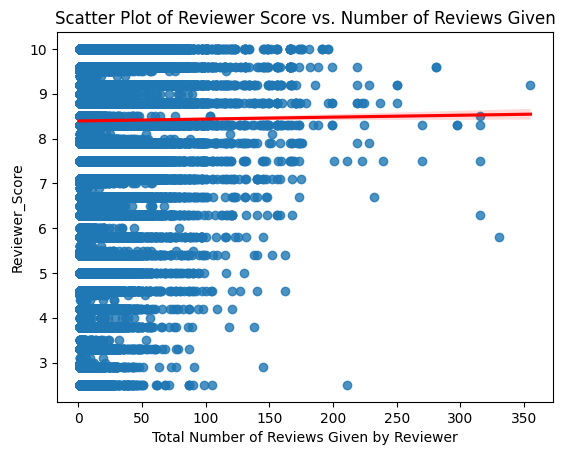

Slope: 0.00042620576740491596
Intercept: 8.39202237895045
R-squared: 8.253596004117355e-06
P-value: 0.039096028691685325


In [5]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

# Assuming 'data' DataFrame is already loaded from previous code

# Create the scatter plot with a linear regression line
sns.regplot(x='Total_Number_of_Reviews_Reviewer_Has_Given', y='Reviewer_Score', data=data, line_kws={'color': 'red'})
plt.xlabel('Total Number of Reviews Given by Reviewer')
plt.ylabel('Reviewer_Score')
plt.title('Scatter Plot of Reviewer Score vs. Number of Reviews Given')
plt.show()

# Calculate the linear regression statistics (optional)
slope, intercept, r_value, p_value, std_err = stats.linregress(data['Total_Number_of_Reviews_Reviewer_Has_Given'], data['Reviewer_Score'])
print(f"Slope: {slope}")
print(f"Intercept: {intercept}")
print(f"R-squared: {r_value**2}")
print(f"P-value: {p_value}")


In [6]:
# prompt: generate OLS regression summary

import statsmodels.api as sm

# Assuming 'data' DataFrame and 'Total_Number_of_Reviews_Reviewer_Has_Given' and 'Reviewer_Score' columns exist

# Define the independent and dependent variables
X = data['Total_Number_of_Reviews_Reviewer_Has_Given']
y = data['Reviewer_Score']

# Add a constant to the independent variable (intercept term)
X = sm.add_constant(X)

# Fit the OLS model
model = sm.OLS(y, X)
results = model.fit()

# Print the regression summary
print(results.summary())


                            OLS Regression Results                            
Dep. Variable:         Reviewer_Score   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     4.257
Date:                Tue, 04 Mar 2025   Prob (F-statistic):             0.0391
Time:                        17:34:16   Log-Likelihood:            -9.8626e+05
No. Observations:              515738   AIC:                         1.973e+06
Df Residuals:                  515736   BIC:                         1.973e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                                 coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------

                            OLS Regression Results                            
Dep. Variable:         Reviewer_Score   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     7.753
Date:                Tue, 04 Mar 2025   Prob (F-statistic):            0.00536
Time:                        06:51:36   Log-Likelihood:            -9.7898e+05
No. Observations:              511944   AIC:                         1.958e+06
Df Residuals:                  511942   BIC:                         1.958e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                                     coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------

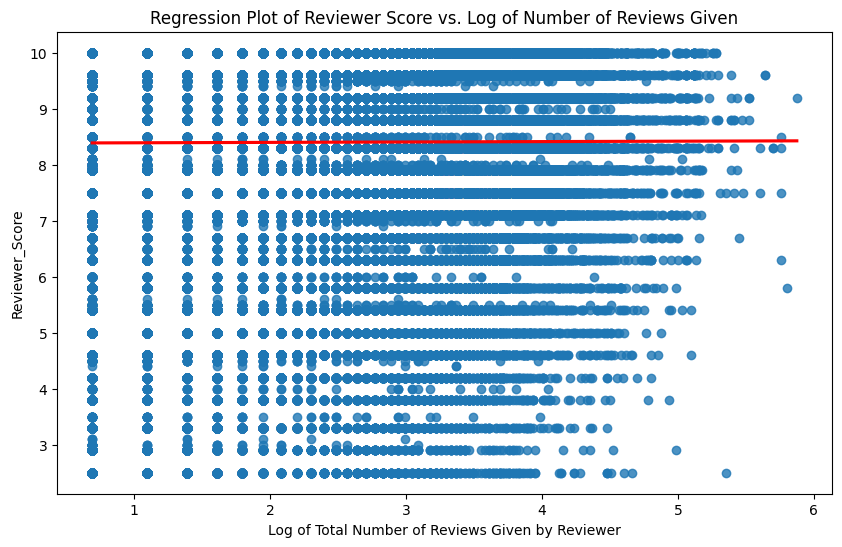

In [ ]:
# prompt: Do a regression between X='Total_Number_of_Reviews_Reviewer_Has_Given' and y='Reviewer_Score', except use log transformation on X and use smf. Plot the graph

import matplotlib.pyplot as plt
import statsmodels.formula.api as smf
import numpy as np

# Assuming 'data' DataFrame is already loaded

# Log transformation of X
data['log_Total_Number_of_Reviews_Reviewer_Has_Given'] = np.log1p(data['Total_Number_of_Reviews_Reviewer_Has_Given'])

# Fit the regression model
model = smf.ols('Reviewer_Score ~ log_Total_Number_of_Reviews_Reviewer_Has_Given', data=data).fit()

# Print model summary
print(model.summary())

# Plotting
plt.figure(figsize=(10, 6))
sns.regplot(x='log_Total_Number_of_Reviews_Reviewer_Has_Given', y='Reviewer_Score', data=data, line_kws={'color': 'red'})
plt.xlabel('Log of Total Number of Reviews Given by Reviewer')
plt.ylabel('Reviewer_Score')
plt.title('Regression Plot of Reviewer Score vs. Log of Number of Reviews Given')
plt.show()


# Attempt: Multivariate Linear Regression (MLR)

## preliminary MLR: No interaction terms

                            OLS Regression Results                            
Dep. Variable:         Reviewer_Score   R-squared:                       0.221
Model:                            OLS   Adj. R-squared:                  0.221
Method:                 Least Squares   F-statistic:                 2.905e+04
Date:                Tue, 04 Mar 2025   Prob (F-statistic):               0.00
Time:                        06:47:00   Log-Likelihood:            -9.1505e+05
No. Observations:              511944   AIC:                         1.830e+06
Df Residuals:                  511938   BIC:                         1.830e+06
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                                 coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------

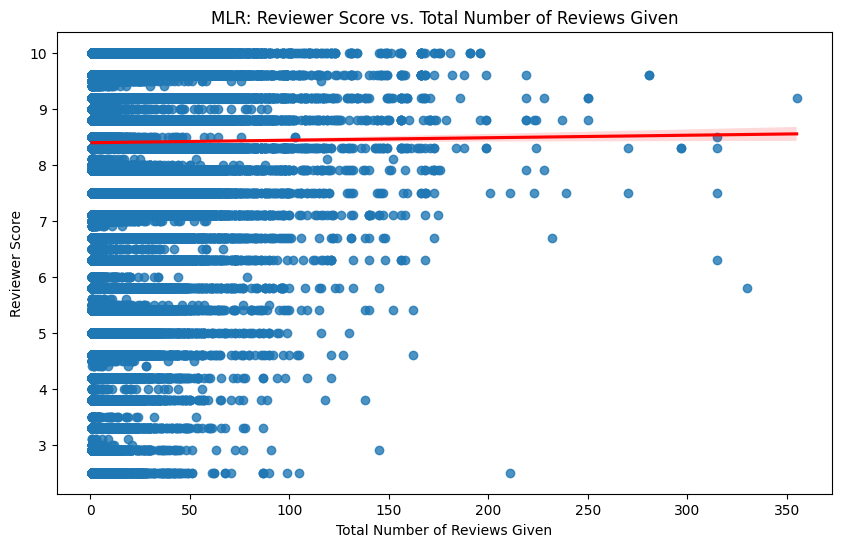

In [ ]:
import matplotlib.pyplot as plt
# Define the independent variables (features) and dependent variable (target)
X = data[['Additional_Number_of_Scoring', 'Total_Number_of_Reviews_Reviewer_Has_Given',
           'Total_Number_of_Reviews', 'Review_Total_Negative_Word_Counts',
          'Review_Total_Positive_Word_Counts', 'Total_Number_of_Reviews_Reviewer_Has_Given',
          ]]
y = data['Reviewer_Score']

# Add a constant to the independent variables for the intercept
X = sm.add_constant(X)

# Fit the MLR model
mlr_model = sm.OLS(y, X).fit()

# Print the model summary
print(mlr_model.summary())

# Plot the regression line (example for one independent variable)
plt.figure(figsize=(10, 6))
sns.regplot(x='Total_Number_of_Reviews_Reviewer_Has_Given', y='Reviewer_Score', data=data, line_kws={'color': 'red'})
plt.xlabel('Total Number of Reviews Given')
plt.ylabel('Reviewer Score')
plt.title('MLR: Reviewer Score vs. Total Number of Reviews Given')
plt.show()


## Trying interaction terms

## Start new (Euniee Code)


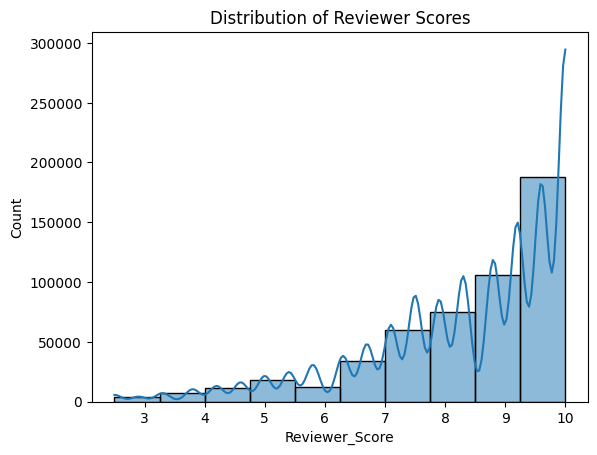

In [ ]:
#Distribution of Reviewer Scores

import seaborn as sns
import matplotlib.pyplot as plt

sns.histplot(data["Reviewer_Score"], bins=10, kde=True)
plt.title("Distribution of Reviewer Scores")
plt.show()

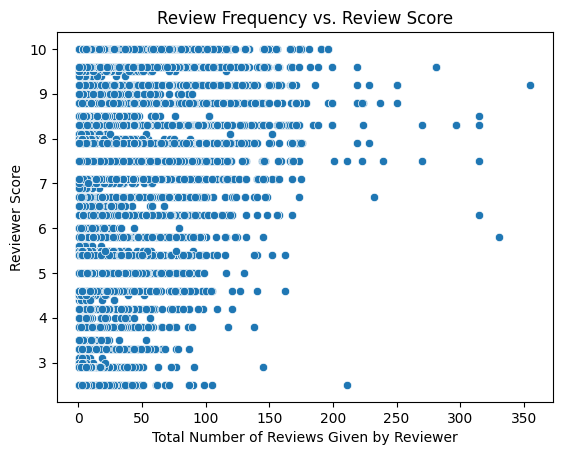

In [ ]:
# Relationship Between Review Frequency and Score
sns.scatterplot(x=data["Total_Number_of_Reviews_Reviewer_Has_Given"], y=data["Reviewer_Score"])
plt.xlabel("Total Number of Reviews Given by Reviewer")
plt.ylabel("Reviewer Score")
plt.title("Review Frequency vs. Review Score")
plt.show()

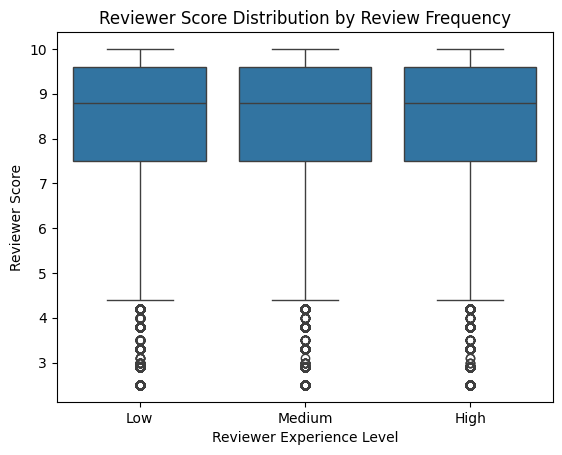

In [ ]:
# Boxplot of Scores by Review Frequency Levels
# Use qcut with 3 labels for 4 quantiles
data["Reviewer_Category"] = pd.qcut(data["Total_Number_of_Reviews_Reviewer_Has_Given"], q=4, labels=["Low", "Medium", "High"], duplicates='drop')

sns.boxplot(x=data["Reviewer_Category"], y=data["Reviewer_Score"])
plt.xlabel("Reviewer Experience Level")
plt.ylabel("Reviewer Score")
plt.title("Reviewer Score Distribution by Review Frequency")
plt.show()

In [ ]:
## Statistical Tests
# Correlation Between Review Frequency and Reviewer Score
from scipy.stats import pearsonr

corr, p_value = pearsonr(data["Total_Number_of_Reviews_Reviewer_Has_Given"], data["Reviewer_Score"])
print(f"Pearson Correlation: {corr}, P-value: {p_value}")

Pearson Correlation: 0.0028729072390379353, P-value: 0.03909602869168844


Pearson Correlation:

Value: 0.0028729072390379353 This value is extremely close to 0. In a Pearson correlation, values range from -1 to +1.

A value of 0 indicates no linear relationship between the two variables.
A value close to +1 indicates a strong positive linear relationship (as one variable increases, the other tends to increase).
A value close to -1 indicates a strong negative linear relationship (as one variable increases, the other tends to decrease).
Interpretation: In your case, the Pearson correlation of approximately 0.0029 suggests that there is virtually no linear relationship between the total number of reviews a reviewer has given (review frequency) and the reviewer's score. This means that whether a reviewer is frequent or infrequent doesn't seem to have a predictable effect on the scores they give.

P-value:

Value: 0.03909602869168844
Interpretation: The p-value is less than the commonly used significance level of 0.05. This means that there is a statistically significant relationship between the two variables. However, given the extremely weak correlation coefficient, it's highly likely to be a spurious correlation and due to random chance of having more data and not of actual effect. In other words, despite the low p-value, the actual relationship is so weak that it is likely of no practical value for our research.
In the context of your research question:

The results suggest that there is no practically significant relationship between review frequency and review score. Neither frequent nor first-time reviewers show a clear tendency to give more lenient or harsher reviews.

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


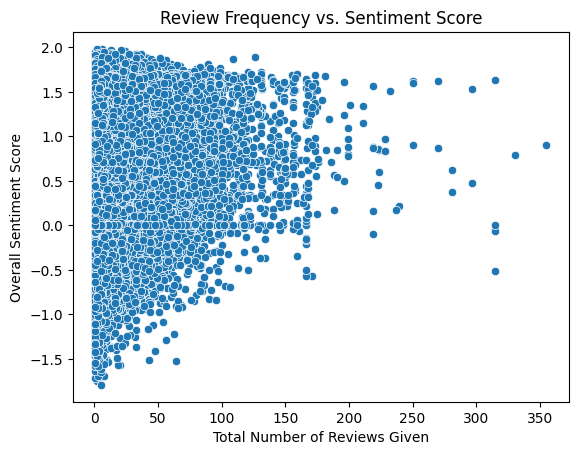

In [ ]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk
nltk.download("vader_lexicon")

sia = SentimentIntensityAnalyzer()

# Compute sentiment score for each review
data["Positive_Sentiment"] = data["Positive_Review"].apply(lambda x: sia.polarity_scores(x)["compound"])
data["Negative_Sentiment"] = data["Negative_Review"].apply(lambda x: sia.polarity_scores(x)["compound"])

# Aggregate Sentiment Score
data["Overall_Sentiment"] = data["Positive_Sentiment"] - data["Negative_Sentiment"]

# Scatter plot: Review Frequency vs Sentiment Score
sns.scatterplot(x=data["Total_Number_of_Reviews_Reviewer_Has_Given"], y=data["Overall_Sentiment"])
plt.xlabel("Total Number of Reviews Given")
plt.ylabel("Overall Sentiment Score")
plt.title("Review Frequency vs. Sentiment Score")
plt.show()


In [ ]:
import statsmodels.api as sm

# Independent variable (add constant for intercept)
X = sm.add_constant(data["Total_Number_of_Reviews_Reviewer_Has_Given"])
y = data["Reviewer_Score"]  # Or df["Overall_Sentiment"]

# Fit regression model
model = sm.OLS(y, X).fit()

# Summary of regression results
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:         Reviewer_Score   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     4.257
Date:                Mon, 03 Mar 2025   Prob (F-statistic):             0.0391
Time:                        23:50:29   Log-Likelihood:            -9.8626e+05
No. Observations:              515738   AIC:                         1.973e+06
Df Residuals:                  515736   BIC:                         1.973e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                                 coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------